In [4]:
import pdb
import ipdb
import math
import torchvision
import torchvision.transforms as transforms
import torch
import numpy as np
import pickle as pkl
import ipdb
import skimage
from skimage.measure import block_reduce
import torch.optim as optim

from IPython.display import Audio

import matplotlib.pyplot as plt
%matplotlib inline
import librosa

class AudioFunctionWrapper:

    def __init__(self):
        self.heap = None

    def initAsm(self, heap_size):
        # rounded_heap_size = getNextValidFloat32HeapLength(heap_size)
        # self.heap = np.zeros(rounded_heap_size)
        self.heap = np.zeros(heap_size)

        # self.audio_funcs = audio_functions(window, foreignFunctions, heapBuffer)
        self.audio_funcs = audio_functions(self.heap)


    def pluckDecayedSine(self, buffer, sample_rate, hz, velocity, decay_factor):

        required_heap_size = len(buffer)

        self.initAsm(required_heap_size)

        heapOffsets = { 'targetStart': 0,
                        'targetEnd': len(buffer) - 1 }

        self.audio_funcs['renderDecayedSine'](heapOffsets['targetStart'],
                                              heapOffsets['targetEnd'],
                                              sample_rate,
                                              hz,
                                              velocity,
                                              decay_factor)

        return self.heap


    def pluck(self, buffer, seedNoise, sample_rate, hz, smoothingFactor,
              velocity, options, acousticLocation):

        required_heap_size = len(seedNoise) + len(buffer)

        self.initAsm(required_heap_size)

        for i in range(len(seedNoise)):
            self.heap[i] = seedNoise[i]

        # ipdb.set_trace()

        heapOffsets = { 'seedStart': 0,
                        'seedEnd': len(seedNoise) - 1,
                        'targetStart': len(seedNoise),
                        'targetEnd': len(seedNoise) + len(buffer) - 1
                      }

        self.audio_funcs['renderKarplusStrong'](heapOffsets['seedStart'],
                                                heapOffsets['seedEnd'],
                                                heapOffsets['targetStart'],
                                                heapOffsets['targetEnd'],
                                                sample_rate,
                                                hz,
                                                velocity,
                                                smoothingFactor,
                                                options.string_tension,
                                                options.pluck_damping,
                                                options.pluck_damping_variation,
                                                options.character_variation)

        if options.body == "simple":
            self.audio_funcs['resonate'](heapOffsets['targetStart'], heapOffsets['targetEnd'])

        self.audio_funcs['fadeTails'](heapOffsets['targetStart'], heapOffsets['targetEnd'] - heapOffsets['targetStart'] + 1)

        # string.acousticLocation is set individually for each string such that
        # the lowest note has a value of -1 and the highest +1

        # stereoSpread = options.stereoSpread * acousticLocation

        # for negative stereoSpreads, the note is pushed to the left
        # for positive stereoSpreads, the note is pushed to the right

        return self.heap[heapOffsets['targetStart']:]


# the byte length must be 2^n for n in [12, 24],
# or for bigger heaps, 2^24 * n for n >= 1
# def getNextValidFloat32HeapLength(desiredLengthFloats):
#     desiredLengthBytes = desiredLengthFloats << 2

#     if desiredLengthBytes <= math.pow(2, 12):
#         heapLengthBytes = math.pow(2, 12)
#     elif (desiredLengthBytes < math.pow(2, 24)):
#         heapLengthBytes = math.pow(2, math.ceil(math.log2(desiredLengthBytes)))
#     else:
#         print("Heap length greater than 2^24 bytes not implemented")

#     return int(heapLengthBytes)


def audio_functions(heapBuffer):

    heap = heapBuffer

    # simple discrete-time low-pass filter from Wikipedia
    def lowPass(lastOutput, currentInput, smoothingFactor):
        currentOutput = smoothingFactor * currentInput + (1.0 - smoothingFactor) * lastOutput
        return currentOutput


    # simple discrete-time high-pass filter from Wikipedia
    def highPass(lastOutput, lastInput, currentInput, smoothingFactor):
        currentOutput = smoothingFactor * lastOutput + smoothingFactor * (currentInput - lastInput)
        return currentOutput


    def resonate(heapStart, heapEnd):
        # explicitly initialise all variables so types are declared
        r00 = 0.0
        f00 = 0.0
        r10 = 0.0
        f10 = 0.0
        f0 = 0.0
        c0 = 0.0
        c1 = 0.0
        r0 = 0.0
        r1 = 0.0
        i = 0

        resonatedSample = 0.0
        resonatedSamplePostHighPass = 0.0
        # by making the smoothing factor large, we make the cutoff
        # frequency very low, acting as just an offset remover
        highPassSmoothingFactor = 0.999
        lastOutput = 0.0
        lastInput = 0.0

        c0 = 2.0 * np.sin(np.pi * 3.4375 / 44100.0)
        c1 = 2.0 * np.sin(np.pi * 6.124928687214833 / 44100.0)
        r0 = 0.98
        r1 = 0.98

        # This for loop replaced by a while loop
        # for (i = heapStart << 2; (i|0) <= (heapEnd << 2); i = (i + 4)|0):
        i = heapStart << 2
        ipdb.set_trace()
        while i <= heapEnd << 2:
            r00 = r00 * r0
            r00 = r00 + (f0 - f00) * c0
            f00 = f00 + r00
            f00 = f00 - f00 * f00 * f00 * 0.166666666666666
            r10 = r10 * r1
            r10 = r10 + (f0 - f10) * c1
            f10 = f10 + r10
            f10 = f10 - f10 * f10 * f10 * 0.166666666666666
            f0 = heap[i >> 2]
            resonatedSample = f0 + (f00 + f10) * 2.0

            # I'm not sure why, but the resonating process plays
            # havok with the DC offset - it jumps around everywhere.
            # We put it back to zero DC offset by adding a high-pass
            # filter with a super low cutoff frequency.
            resonatedSamplePostHighPass = highPass(lastOutput, lastInput, resonatedSample, highPassSmoothingFactor)
            heap[i >> 2] = resonatedSamplePostHighPass
            lastOutput = resonatedSamplePostHighPass
            lastInput = resonatedSample

            i = i + 4


    # apply a fade envelope to the end of a buffer
    # to make it end at zero ampltiude
    # (to avoid clicks heard when sample otherwise suddenly
    #  cuts off)
    def fadeTails(heapStart, length):
        heapEnd = 0
        tailProportion = 0.0
        tailSamples = 0
        tailSamplesStart = 0
        i = 0
        samplesThroughTail = 0
        proportionThroughTail = 0.0
        gain = 0.0

        tailProportion = 0.1
        tailSamples = int(np.floor(length * tailProportion))
        tailSamplesStart = heapStart + length - tailSamples

        heapEnd = heapStart + length
        i = tailSamplesStart << 2
        samplesThroughTail = 0

        # for (i = tailSamplesStart << 2, samplesThroughTail = 0; (i|0) < (heapEnd << 2); i = (i + 4)|0, samplesThroughTail = (samplesThroughTail+1)|0):
        while i < heapEnd << 2:
            proportionThroughTail = samplesThroughTail / tailSamples
            gain = 1.0 - proportionThroughTail
            heap[i >> 2] = heap[i >> 2] * gain

            i += 4
            samplesThroughTail += 1


    # the "smoothing factor" parameter is the coefficient
    # used on the terms in the main low-pass filter in the
    # Karplus-Strong loop
    def renderKarplusStrong(seedNoiseStart,
                            seedNoiseEnd,
                            targetArrayStart,
                            targetArrayEnd,
                            sample_rate, hz, velocity,
                            smoothingFactor, stringTension,
                            pluckDamping,
                            pluckDampingVariation,
                            characterVariation):

        period = 0.0
        periodSamples = 0
        sampleCount = 0
        lastOutputSample = 0.0
        curInputSample = 0.0
        noiseSample = 0.0
        skipSamplesFromTension = 0
        curOutputSample = 0.0
        pluckDampingMin = 0.0
        pluckDampingMax = 0.0
        pluckDampingVariationMin = 0.0
        pluckDampingVariationMax = 0.0
        pluckDampingVariationDifference = 0.0
        pluckDampingCoefficient = 0.0

        # the index of the heap as a whole that we get noise samples from
        heapNoiseIndexBytes = 0
        # the index of the portion of the heap that we'll be writing to
        targetIndex = 0
        # the index of the heap as a whole where we'll be writing
        heapTargetIndexBytes = 0
        # the index of the heap as a whole of the start of the last period of samples
        lastPeriodStartIndexBytes = 0
        # the index of the heap as a whole from where we'll be taking samples from the last period, after
        # having added the skip from tension
        lastPeriodInputIndexBytes = 0
        period = 1.0 / hz
        periodSamples = int(np.round(period * sample_rate))
        sampleCount = targetArrayEnd - targetArrayStart + 1

        # /*
        # |- pluckDampingMax
        # |
        # |               | - pluckDampingVariationMax         | -
        # |               | (pluckDampingMax - pluckDamping) * |
        # |               | pluckDampingVariation              | pluckDamping
        # |- pluckDamping | -                                  | Variation
        # |               | (pluckDamping - pluckDampingMin) * | Difference
        # |               | pluckDampingVariation              |
        # |               | - pluckDampingVariationMin         | -
        # |
        # |- pluckDampingMin
        # */
        pluckDampingMin = 0.1
        pluckDampingMax = 0.9
        pluckDampingVariationMin = pluckDamping - (pluckDamping - pluckDampingMin) * pluckDampingVariation
        pluckDampingVariationMax = pluckDamping + (pluckDampingMax - pluckDamping) * pluckDampingVariation
        pluckDampingVariationDifference = pluckDampingVariationMax - pluckDampingVariationMin
        pluckDampingCoefficient = pluckDampingVariationMin + np.random.rand() * pluckDampingVariationDifference

        # for (targetIndex = 0; (targetIndex|0) < (sampleCount|0); targetIndex = (targetIndex + 1)|0):
        targetIndex = 0
        while targetIndex < sampleCount:

            heapTargetIndexBytes = (targetArrayStart + targetIndex) << 2

            if targetIndex < periodSamples:
                # for the first period, feed in noise remember, heap index has to be bytes...
                heapNoiseIndexBytes = (seedNoiseStart + targetIndex) << 2
                noiseSample = heap[heapNoiseIndexBytes >> 2]
                # create room for character variation noise
                noiseSample = noiseSample * (1.0 - characterVariation)
                # add character variation
                noiseSample = noiseSample + characterVariation * (-1.0 + 2.0 * np.random.rand())
                # also velocity
                noiseSample = noiseSample * velocity
                # by varying 'pluck damping', we can control the spectral content of the input noise
                curInputSample = lowPass(curInputSample, noiseSample, pluckDampingCoefficient)
            elif stringTension != 1.0:
                # for subsequent periods, feed in the output from about one period ago
                lastPeriodStartIndexBytes = heapTargetIndexBytes - (periodSamples << 2)
                skipSamplesFromTension = int(np.floor(stringTension * periodSamples))
                lastPeriodInputIndexBytes = lastPeriodStartIndexBytes + (skipSamplesFromTension << 2)
                curInputSample = heap[lastPeriodInputIndexBytes >> 2]
            else:
                # if stringTension == 1.0, we would be reading from the
                # same sample we were writing to
                # ordinarily, self would have the effect that only the first
                # period of noise was preserved, and the rest of the buffer
                # would be silence, but because we're reusing the heap,
                # we'd actually be reading samples from old waves
                curInputSample = 0.0

            # the current period is generated by applying a low-pass
            # filter to the last period
            curOutputSample = lowPass(lastOutputSample, curInputSample, smoothingFactor)

            heap[heapTargetIndexBytes >> 2] = curOutputSample
            lastOutputSample = curOutputSample

            targetIndex += 1


    def renderDecayedSine(targetArrayStart,
                          targetArrayEnd,
                          sample_rate, hz, velocity,
                          decay_factor):
        period = 0.0
        periodSamples = 0
        sampleCount = 0
        # the index of the portion of the heap that we'll be writing to
        targetIndex = 0
        # the index of the heap as a whole where we'll be writing
        heapTargetIndexBytes = 0

        time = 0.0

        period = 1.0 / hz
        periodSamples = np.round(period * sample_rate)
        sampleCount = targetArrayEnd - targetArrayStart + 1

        # for (targetIndex = 0; (targetIndex|0) < (sampleCount|0); targetIndex = (targetIndex + 1)|0):
        targetIndex = 0
        while targetIndex < sampleCount:

            heapTargetIndexBytes = (targetArrayStart + targetIndex) << 2

            time = targetIndex / sample_rate
            heap[heapTargetIndexBytes >> 2] = velocity * math.pow(2.0, -decay_factor*time) * np.sin(2.0 * np.pi * hz * time)

            targetIndex += 1

    return { 'renderKarplusStrong': renderKarplusStrong,
             'renderDecayedSine': renderDecayedSine,
             'fadeTails': fadeTails,
             'resonate': resonate }


In [118]:
def cqt_specgram(audio, n_bins, bins_per_octave, hop_length, sr, fmin, filter_scale):
    '''
    :param audio:
    :param sr:
    :return: shape = (n_bins, t)
    '''
    c = librosa.cqt(audio, sr = sr, n_bins = n_bins, bins_per_octave = bins_per_octave, hop_length = hop_length,
                    fmin = fmin, filter_scale = filter_scale)
    mag, phase = librosa.core.magphase(c)
    c_p = librosa.amplitude_to_db(mag, amin=1e-13, top_db=120., ref=np.max) / 120.0 + 1.0
    return c_p

In [119]:
def compute_cqt_spec(audio, n_bins = 84 * 4, bins_per_octave=12 * 4, hop_length = 256, sr = 16000, fmin = librosa.note_to_hz('C1'),
             filter_scale = 0.8):
    return cqt_specgram(audio, n_bins, bins_per_octave, hop_length, sr, fmin, filter_scale)

In [120]:
def generate_seed_noise(num_samples):
    return np.random.rand(num_samples) * 2 - 1


#  calculate the constant used for the low-pass filter
# used in the Karplus-Strong loop
def calculate_smoothing_factor(string, tab, options):
    if options.string_damping_calculation == "direct":
        return options.string_damping
    elif options.string_damping_calculation == "magic":
        noteNumber = (string.semitone_index + tab - 19) / 44
        return options.string_damping + math.pow(noteNumber, 0.5) * (1 - options.string_damping) * 0.5 + (1 - options.string_damping) * np.random.rand() * options.string_damping_variation


class GuitarString:
    def __init__(self, string_num, octave, semitone, options):

        self.options = options

        # work from A0 as a reference,
        # since it has a nice round frequency
        a0_hz = 27.5
        # an increase in octave by 1 doubles the frequency
        # each octave is divided into 12 semitones
        # the scale goes C0, C0#, D0, D0#, E0, F0, F0#, G0, G0#, A0, A0#, B0
        # so go back 9 semitones to get to C0
        c0_hz = a0_hz * math.pow(2, -9 / 12)
        self.basicHz = c0_hz * math.pow(2, octave + semitone / 12)

        # ipdb.set_trace()
        basic_period = 1.0 / self.basicHz
        basic_period_num_samples = int(np.round(basic_period * 40000))  # TODO: audioCtx.sample_rate == 4000 ?
        self.seed_noise = generate_seed_noise(basic_period_num_samples)

        # this is only used in a magical calculation of filter coefficients
        self.semitone_index = octave * 12 + semitone - 9

        # ranges from -1 for first string to +1 for last
        self.acoustic_location = (string_num - 2.5) * 0.4
        #print(self.acoustic_location)
        #print(string_num)
        # self.mode = "karplus-strong"
        # self.mode = "sine"
        self.mode = options.mode
        self.func_wrapper = AudioFunctionWrapper()


    def createBuffer(self, sample_count):
        # We use 1 channel for simplicity
        return np.zeros(sample_count)


    def pluck(self, start_time, velocity, tab, freq, smoothing_factor):
        # create the buffer we're going to write into
        channels = 1
        sample_rate = 40000  # TODO: audioCtx.sample_rate == 4000 ?
        sample_count = int(2.0 * sample_rate)  # 1 second buffer

        # buffer = self.createBuffer(channels, sample_count, sample_rate)
        buffer = self.createBuffer(sample_count)

        #smoothing_factor = calculate_smoothing_factor(self, tab, self.options)
        #print(smoothing_factor)
        # 'tab' represents which fret is held while plucking
        # each fret represents an increase in pitch by one semitone
        # (logarithmically, one-twelth of an octave)
        #hz = self.basicHz * math.pow(2, tab / 12)
        hz = freq

        velocity /= 4.0

        if self.mode == "karplus-strong":
            filled_buffer = self.func_wrapper.pluck(buffer,
                                                    self.seed_noise,
                                                    sample_rate,
                                                    hz,
                                                    smoothing_factor,
                                                    velocity,
                                                    self.options,
                                                    self.acoustic_location)
        elif self.mode == "sine":
            decayFactor = 8
            filled_buffer = self.func_wrapper.pluckDecayedSine(buffer,
                                                               sample_rate,
                                                               hz,
                                                               velocity,
                                                               decayFactor)

        return filled_buffer


In [121]:
class Guitar:

    # each fret represents an increase in pitch by one semitone
    # (logarithmically, one-twelth of an octave)
    # -1: don't pluck that string
    C_MAJOR = [-1, 3, 2, 0, 0, 0]
    G_MAJOR = [ 3, 2, 0, 0, 0, 3]
    A_MINOR = [ 0, 0, 2, 2, 0, 0]
    E_MINOR = [ 0, 2, 2, 0, 3, 0]

    def __init__(self, options):

        self.options = options

        self.strings = [
            # arguments are:
            # - string number
            # - octave
            # - semitone
            GuitarString(0, 2, 4,  options),   # E2
            GuitarString(1, 2, 9,  options),   # A2
            GuitarString(2, 3, 2,  options),   # D3
            GuitarString(3, 3, 7,  options),   # G3
            GuitarString(4, 3, 11, options),   # B3
            GuitarString(5, 4, 4,  options)    # E4
        ]

        
    def note(self, velocity, stringNumber, tab, freq, smoothing_factor):
        buffer_result = self.strings[stringNumber].pluck(0, velocity, tab, freq, smoothing_factor)
        return buffer_result
        
    def strum_chord(self, time, downstroke, velocity, chord):
    #def strum_chord(self, time, downstroke, velocity, chord, stringNumber):
        if downstroke:
            pluckOrder = [0, 1, 2, 3, 4, 5]
        else:
            pluckOrder = [5, 4, 3, 2, 1, 0]

        note_buffers = []

        for i in range(6):
            stringNumber = pluckOrder[i]
            if chord[stringNumber] != -1:
                # buffer_result = self.strings[stringNumber].pluck(time, velocity, chord[stringNumber])
                buffer_result = self.strings[stringNumber].pluck(0, velocity, chord[stringNumber])
                note_buffers.append(buffer_result)

            time += np.random.rand() / 128  # Do we want rand or randn? Or rand() centered at 0?

        as_strided = np.lib.stride_tricks.as_strided
        all_notes = np.concatenate(note_buffers)

        if chord[stringNumber] != -1:
            buffer_result = self.strings[stringNumber].pluck(0, velocity, chord[stringNumber])
            note_buffers.append(buffer_result)
        # overlap = 39000  # For 1-second samples
        overlap = 78000  # For 2-second samples
        added_notes = note_buffers[0]
        if len(note_buffers) > 1:
            for i in range(1, len(note_buffers)):
                added_notes = np.concatenate([added_notes[:-overlap], added_notes[-overlap:] + note_buffers[i][:overlap], note_buffers[i][overlap:]])

        # ipdb.set_trace()
        # added_notes = as_strided(all_notes, (6, 100), all_notes.strides * 2)

        # return np.concatenate(note_buffers)
        return added_notes

    def set_mode(self, mode):
        for string in self.strings:
            string.mode = mode


In [122]:
time_unit = 0.12

chords = [ Guitar.C_MAJOR,
           Guitar.G_MAJOR,
           Guitar.A_MINOR,
           Guitar.E_MINOR ]


# def play_strums(guitar, sequenceN, block_start_time, chord_index, precache_time):

#     cur_strum_start_time = 0

#     audio_buffers = []

#     #for i in range(13):
#     for i in range(1):
#         print(i)
#         chord = chords[chord_index]

#         if sequenceN % 13 == 0:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 1:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 2:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 3:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 4:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 5:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 6:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 7:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 8:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 9:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 10:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 11:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 12:
#             audio_buffer = guitar.strings[2].pluck(cur_strum_start_time, 0.7, chord[2])

#             # cur_strum_start_time = block_start_time + time_unit * 31.5
#             # audio_buffer = guitar.strings[1].pluck(cur_strum_start_time, 0.7, chord[1])

#             chord_index = (chord_index + 1) % 4
#             # block_start_time += time_unit * 32

#         chord_index = (chord_index + 1) % 4

#         audio_buffers.append(audio_buffer)
#         sequenceN += 1
#     return np.concatenate(audio_buffers)


def play_note(guitar, stringNumber, tab, freq, smoothing_factor):
    audio_buffer = guitar.note(1.0, stringNumber, tab, freq, smoothing_factor)
    return audio_buffer


def play_strums(guitar, sequenceN, block_start_time, chord_index, precache_time):
    cur_strum_start_time = 0
    chord = chords[chord_index]
    audio_buffer = guitar.strum_chord(cur_strum_start_time, True, 1.0, chord)
    return audio_buffer


def play_guitar(guitar):
    start_sequence_N = 0
    block_start_time = 10
    start_chord_index = 1
    precache_time = 0.0
    return play_strums(guitar, start_sequence_N, block_start_time, start_chord_index, precache_time)


In [123]:
# target:pitch from freqs -> compute stringNumber, tab -> pluck -> cqt
# input:cqt -> learn freqs

a0_hz = 27.5
c0_hz = a0_hz * math.pow(2, -9 / 12)

def compute_freq(octave, semitone):
    basicHz = c0_hz * math.pow(2, octave + semitone / 12)
    return basicHz


def compute_basicHz():
    basicHz = []
    basicHz.append(c0_hz * math.pow(2, 2 + 4 / 12))  #E2
    basicHz.append(c0_hz * math.pow(2, 2 + 9 / 12))  #A2
    basicHz.append(c0_hz * math.pow(2, 3 + 2 / 12))  #D3
    basicHz.append(c0_hz * math.pow(2, 3 + 7 / 12))  #G3
    basicHz.append(c0_hz * math.pow(2, 3 + 11 / 12)) #B3
    basicHz.append(c0_hz * math.pow(2, 4 + 4 / 12))  #E4
    return basicHz
    
    
def compute_freqs(num_frets):
    freqs = []
    num_octaves = 2 + num_frets // 12
    num_semitones = num_octaves * 12 + num_frets % 12 + 1
    for i in range(4, num_semitones + 4):
        freqs.append(compute_freq(2, i))
    return freqs

                   
def compute_pitch(stringNumber, fret):
    strings = compute_basicHz()
    return strings[stringNumber] * math.pow(2, fret/12)

                   
def get_string_tab(freq, num_frets):
    l = []
    for i in range(6):
        for j in range(num_frets + 1):
            if math.isclose(compute_pitch(i, j), freq, rel_tol=1e-5):
                   l.append([int(round(i)), int(round(j))])
    return l

In [124]:
class Options:
    
    def __init__(self, character_variation = 0.5, string_damping=0.5, string_damping_variation=0.25, pluck_damping=0.5,
                pluck_damping_variation=0.25, string_tension=0.1, stereo_spread=0.5, string_damping_calculation='magic', 
                body='simple', mode='karplus-strong'):

        self.character_variation = character_variation
        self.string_damping=string_damping
        self.string_damping_variation=string_damping_variation
        self.pluck_damping=pluck_damping
        self.pluck_damping_variation=pluck_damping_variation
        self.string_tension=string_tension
        self.stereo_spread=stereo_spread
        self.string_damping_calculation=string_damping_calculation
        self.body=body
        self.mode=mode

In [125]:
from IPython.display import Audio
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 0, 0)
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

TypeError: play_note() missing 2 required positional arguments: 'freq' and 'smoothing_factor'

0.60624096716955


(336, 313)


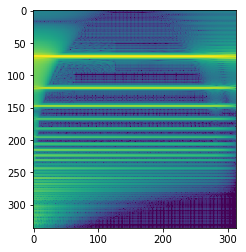

In [53]:
# 7 params + pitch + smoothing_factor --> 
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 0, 0, compute_pitch(0, 0))
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)


0.678488636581266


(336, 313)


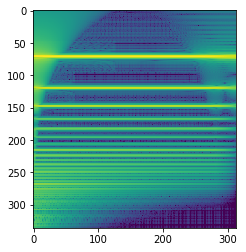

In [63]:
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 0, 4, compute_pitch(0, 0))
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

0.8058907898271634


(336, 313)


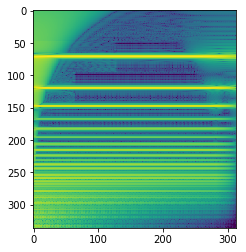

In [64]:
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 5, 4, compute_pitch(0, 0))
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

0.8


(336, 313)


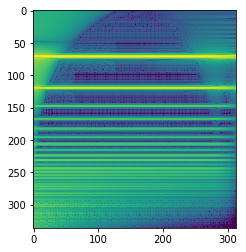

In [75]:
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 0, 0, compute_pitch(0, 0), 0.8)
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

0.8


(336, 313)


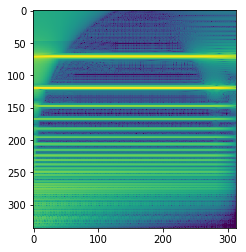

In [77]:
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 5, 20, compute_pitch(0, 0), 0.8)
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

In [126]:
def pad_zeros(image, shape):
    result = np.zeros(shape)
    result[:image.shape[0],:image.shape[1]] = image
    return result

In [84]:
num_frets = 20
def sample_params_pitch_sf(size):
    freqs = np.array(compute_freqs(num_frets))
    character_variation = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    string_damping = np.array([np.random.uniform(0, 0.7) for _ in range(size)], dtype=np.float32)
    string_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    pluck_damping = np.array([np.random.uniform(0, 0.9) for _ in range(size)], dtype=np.float32)
    pluck_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    string_tension = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    stereo_spread = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    smoothing_factor = np.array([np.random.uniform(0.5, 1) for _ in range(size)], dtype=np.float32)
    pitch = np.array([np.random.choice(freqs) for _ in range(size)], dtype=np.float32)
    #  ipdb.set_trace()
    options = []
    guitars = []
    audio_buffers = []
    cqt_specs = []
    for i in range(size):
        options.append(Options(character_variation[i], string_damping[i], string_damping_variation[i], pluck_damping[i], pluck_damping_variation[i], 
                         string_tension[i], stereo_spread[i]))
        guitars.append(Guitar(options=options[i]))
        audio_buffers.append(play_note(guitars[i], 0, 0, pitch[i], smoothing_factor[i]))
#        print(audio_buffers[i])
#         try:
#             cqt_spec = compute_cqt_spec(audio_buffers[i]).T
#         except ParameterError:
#             print(audio_buffers[i])
        cqt_spec = compute_cqt_spec(audio_buffers[i]).T
        padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
        cqt_specs.append(padded_cqt)
    cqt_specs = np.array(cqt_specs, dtype=np.float32)
    print(cqt_specs.shape)
    return character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, pitch, smoothing_factor, cqt_specs
        

def generate_data_pitch_sf(file, size):
    character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, pitch, smoothing_factor, cqt_specs = sample_params_pitch_sf(size)
    with open(file, 'wb') as fh:
        data_dict = {'parameters' : np.array([character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, 
                stereo_spread, pitch, smoothing_factor]).T, 'cqt_spec' : cqt_specs}
        pkl.dump(data_dict, fh)
    fh.close()
    print(file)

In [90]:
def read_data(file):
    with open(file, 'rb') as fh:
        data = pkl.loads(fh.read())
    fh.close()
    return data


def create_datasets(suffix):
#    generate_data_pitch_sf("val" + suffix + ".pkl", 500)
#     generate_data('test.pkl', 5000)
#     generate_data('eval.pkl', 5000)
#     generate_data('train.pkl', 50000)
#    generate_data_pitch_sf("test" + suffix + ".pkl", 500)
#    generate_data_pitch_sf("eval" + suffix + ".pkl", 100)
    generate_data_pitch_sf("train" + suffix + ".pkl", 4000)

    
def read_dataset(suffix):
    return read_data("train" + suffix + ".pkl"), read_data("test" + suffix + ".pkl"), read_data("val" + suffix + ".pkl"), read_data("eval" + suffix + ".pkl")

def load_data(suffix):
    create_datasets(suffix)
    #data.generate_data('val.pkl', 5000)
    print("loading data...")
    train_data, test_data, val_data, eval_data = read_dataset(suffix)
    print("data loaded")
    return train_data, test_data, val_data, eval_data

In [91]:
train_data, test_data, val_data, eval_data = load_data("_pitch_sf")

(4000, 336, 336)
train_pitch_sf.pkl
loading data...
data loaded


In [127]:
import torch

class MyDataset(torch.utils.data.Dataset):
    def __init__(self, parameters, cqt_spectrograms):
        super(MyDataset, self).__init__()
        
        self.parameters = parameters
        self.cqt_spec = cqt_spectrograms
        #print(self.parameters.shape)
    
    def __getitem__(self, i):
        #print(self.parameters[i].shape)
        return self.cqt_spec[i].T, self.parameters[i]
    
    def __len__(self):
        return len(self.parameters)

In [128]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = MyDataset(parameters=train_data['parameters'], cqt_spectrograms=train_data['cqt_spec'])
trainloader = torch.utils.data.DataLoader(trainset, batch_size=32,
                                          shuffle=True, num_workers=2)

testset = MyDataset(parameters=test_data['parameters'], cqt_spectrograms=test_data['cqt_spec'])
testloader = torch.utils.data.DataLoader(testset, batch_size=32,
                                         shuffle=False, num_workers=2)

valset = MyDataset(parameters=val_data['parameters'], cqt_spectrograms=val_data['cqt_spec'])
valloader = torch.utils.data.DataLoader(valset, batch_size=32,
                                         shuffle=False, num_workers=2)

evalset = MyDataset(parameters=eval_data['parameters'], cqt_spectrograms=eval_data['cqt_spec'])
evalloader = torch.utils.data.DataLoader(evalset, batch_size=4,
                                         shuffle=False, num_workers=2)

In [129]:
import torch.nn as nn
import torch.nn.functional as F


class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(9 * 108 * 108, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 9)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 9 * 108 * 108)  # -1 is the batch_size
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net()

In [130]:
criterion = nn.MSELoss()
#optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)
optimizer = optim.Adam(net.parameters(), lr=0.001)

In [131]:
def evaluate(net, validation_loader):
    val_loss = 0.0
    for i, data in enumerate(validation_loader, 0):

        inputs, labels = data
        inputs.unsqueeze_(1)
    
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())

        # print statistics
        val_loss += loss.item()
    return val_loss / 500

In [ ]:
for epoch in range(20):  # loop over the dataset multiple times

    running_loss = 0.0

    for i, data in enumerate(trainloader, 0):
        # get the inputs
        inputs, labels = data
        #print(inputs.shape)
        #print(labels.shape)
        inputs.unsqueeze_(1)
        #print(inputs.shape)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#        if i % 500 == 0:    # print every 20 mini-batches
#            print('[%d, %5d] loss: %.3f' %
#                  (epoch + 1, i + 1, running_loss/500))
#            running_loss = 0.0

    print('epoch %d train_loss: %.6f' % (epoch + 1, running_loss/4000))
    with open("train_losses_pitch_sf.txt", "a") as text_file:
        text_file.write(str(running_loss/4000))
        text_file.write("\n")
    
    val_loss = evaluate(net, valloader)
    print('epoch %d val_loss: %.6f' % (epoch + 1, val_loss))
    with open("val_losses_pitch_sf.txt", "a") as text_file:
        text_file.write(str(val_loss))
        text_file.write("\n")
    torch.save(net.state_dict(), 'checkpoint_pitch_sf.pt')

print('Finished Training')

epoch 1 train_loss: 241.752776
epoch 1 val_loss: 163.599272
epoch 2 train_loss: 161.447812
epoch 2 val_loss: 156.506894
epoch 3 train_loss: 156.890790
epoch 3 val_loss: 157.381288
epoch 4 train_loss: 158.484863
epoch 4 val_loss: 163.455475
epoch 5 train_loss: 155.915950
epoch 5 val_loss: 151.626939
epoch 6 train_loss: 156.838125
epoch 6 val_loss: 151.151044
epoch 7 train_loss: 152.480597
epoch 7 val_loss: 152.512291
epoch 8 train_loss: 151.718638
epoch 8 val_loss: 159.697213
epoch 9 train_loss: 147.301760
epoch 9 val_loss: 143.697219
epoch 10 train_loss: 137.279721
epoch 10 val_loss: 126.949509
epoch 11 train_loss: 118.046087
epoch 11 val_loss: 235.491496
epoch 12 train_loss: 107.789937
epoch 12 val_loss: 112.035280
epoch 13 train_loss: 86.552837
epoch 13 val_loss: 111.771715
epoch 14 train_loss: 83.250080
epoch 14 val_loss: 106.930831
epoch 15 train_loss: 76.332846
epoch 15 val_loss: 80.974150


In [100]:
def merge_images(sources, targets, k=10):
    _, _, h, w = sources.shape
    print(sources.shape[0], h, w)
    row = int(np.sqrt(sources.shape[0]))  # Square root of batch size
    merged = np.zeros([row*h, row*w*2])
    for idx, (s, t) in enumerate(zip(sources, targets)):
        i = idx // row
        j = idx % row
        merged[i*h:(i+1)*h, (j*2)*h:(j*2+1)*h] = s
        merged[i*h:(i+1)*h, (j*2+1)*h:(j*2+2)*h] = t
    return merged

In [101]:
inputs, targets = iter(trainloader).next()

gt_samples = []
gt_pitches = []
gt_smoothing_factors = []

for i in range(len(targets)):
    gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread, gt_pitch, gt_smoothing_factor = targets.numpy()[i]
    options = Options(gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread)
    guitar = Guitar(options=options)
    gt_pitches.append(gt_pitch)
    gt_smoothing_factors.append(gt_smoothing_factor)
    #print("gt_stringNumber: %.3f, gt_tab: %.3f" % (gt_stringNumber, gt_tab))
    audio_buffer = play_note(guitar, 0, 0, gt_pitch, gt_smoothing_factor)
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))    
    gt_samples.append(audio_buffer)

print(gt_pitches)
print(gt_smoothing_factors)

[246.94165, 138.59131, 329.62756, 184.99721, 830.6094, 329.62756, 261.62558, 466.16376, 123.470825, 110.0, 155.56349, 277.18262, 493.8833, 164.81378, 195.99771, 329.62756, 174.61412, 698.4565, 110.0, 369.99442, 220.0, 82.40689, 87.30706, 87.30706, 523.25116, 329.62756, 440.0, 293.66476, 622.25397, 92.498604, 246.94165, 138.59131]
[0.5008212, 0.6811494, 0.8029508, 0.5536793, 0.96088225, 0.84868264, 0.7830107, 0.93366086, 0.910168, 0.89632195, 0.74830973, 0.7113698, 0.6092843, 0.6555303, 0.570297, 0.98389554, 0.9369276, 0.886045, 0.9068513, 0.7325191, 0.58354205, 0.9075123, 0.8837908, 0.81238973, 0.62689906, 0.80214405, 0.80922204, 0.5711524, 0.7031302, 0.9944803, 0.6015855, 0.6092974]


In [106]:
#net.load_state_dict(torch.load('checkpoint_pitch_sf_sm.pt'))

preds = net(inputs.unsqueeze_(1))
preds = preds.detach().numpy()

pred_samples = []
pred_cqts = []
pred_pitches = []
pred_smoothing_factors = []

for i in range(preds.shape[0]):
    pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, pred_string_tension, pred_stereo_spread, pred_pitch, pred_smoothing_factor = preds[i]
    options = Options(pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, pred_string_tension, pred_stereo_spread)
    guitar = Guitar(options=options)
    #print("pred_stringNumber: %d, pred_tab: %d" % (int(round(pred_stringNumber)), int(round(pred_tab))))
    pred_pitches.append(pred_pitch)
    pred_smoothing_factors.append(pred_smoothing_factor)
    #print("gt_stringNumber: %.3f, gt_tab: %.3f" % (gt_stringNumber, gt_tab))
    audio_buffer = play_note(guitar, 0, 0, pred_pitch, pred_smoothing_factor)
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    pred_cqts.append(padded_cqt.T)
    pred_samples.append(audio_buffer)

print(pred_pitches)
print(pred_smoothing_factors)

AttributeError: module 'torch._C' has no attribute '_cuda_getDevice'

16 336 336


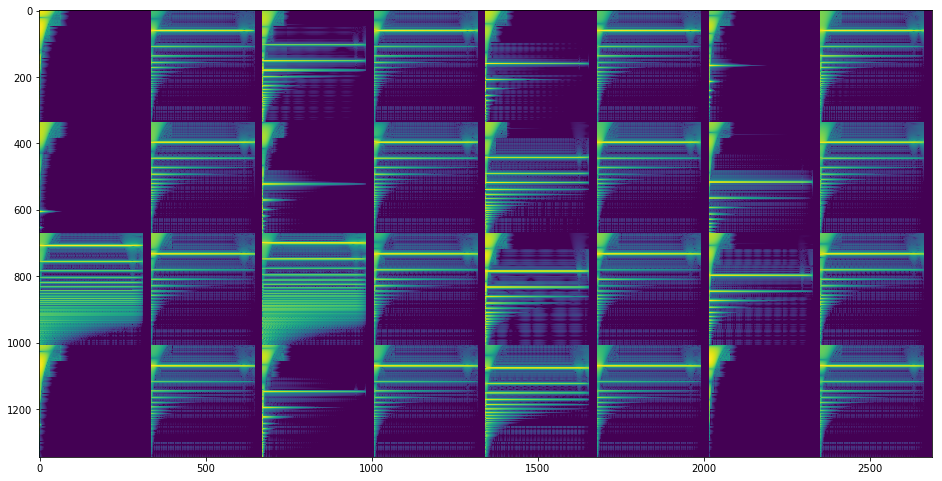

In [103]:
plt.figure(figsize=(16,12))
plt.imshow(merge_images(inputs.numpy()[:16], pred_cqts[:16]))

In [104]:
for i in range(len(gt_samples)):
    print("GT")
    display(Audio(gt_samples[i], rate=36000))
    print("Pred")
    display(Audio(pred_samples[i], rate=36000))

GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


In [1]:
logfile = open("train_losses.txt", "r")
for i, line in zip(range(200), logfile):
    if i%2==0:
        tr = open("train_losses_pitch_sf.txt", "a")
        tr.write(line[20:])
    else:
        va = open("val_losses_pitch_sf.txt", "a")
        va.write(line[18:])

In [6]:
def plot_curves():
    train_losses = []
    logfile = open("train_losses_pitch_sf.txt","r")
    for line in logfile:
        train_losses.append(float(line))
    val_losses = []
    logfile = open("val_losses_pitch_sf.txt","r")
    for line in logfile:
        val_losses.append(float(line))
    t = np.linspace(0, len(val_losses[20:]), len(val_losses[20:]))
    plt.plot(t, np.array(train_losses[20:]), 'r')
    plt.plot(t, np.array(val_losses[20:]), 'b')
    plt.show()

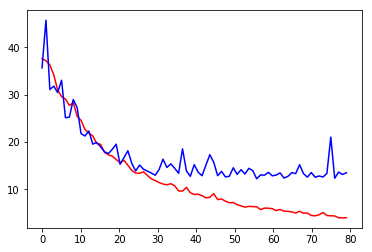

In [7]:
plot_curves()

In [12]:
import pickle as pkl
from IPython.display import Audio

def merge_images(sources, targets, k=10):
    _, h, w = sources.shape
    print(sources.shape[0], h, w)
    row = int(np.sqrt(sources.shape[0]))  # Square root of batch size
    merged = np.zeros([row*h, row*w*2])
    for idx, (s, t) in enumerate(zip(sources, targets)):
        i = idx // row
        j = idx % row
        merged[i*h:(i+1)*h, (j*2)*h:(j*2+1)*h] = s
        merged[i*h:(i+1)*h, (j*2+1)*h:(j*2+2)*h] = t
    return merged

def plot_cqts():
    with open("gt_data_pitch_sf_sm.pkl", 'rb') as fh:
        gt_data = pkl.loads(fh.read())
    fh.close()
    gt_cqts = gt_data['gt_cqts']
    gt_samples = gt_data['gt_samples']
    gt_pitches = gt_data['gt_pitches']
    gt_smoothing_factors = gt_data['gt_smoothing_factors']
    
    with open("pred_data_pitch_sf_sm.pkl", 'rb') as fh:
        pred_data = pkl.loads(fh.read())
    fh.close()
    pred_cqts = pred_data['pred_cqts']
    pred_samples = pred_data['pred_samples']
    pred_pitches = pred_data['pred_pitches']
    pred_smoothing_factors = pred_data['pred_smoothing_factors']
    
    plt.figure(figsize=(16,12))
    plt.imshow(merge_images(gt_cqts[:16], pred_cqts[:16]))
    return gt_samples, gt_pitches, gt_smoothing_factors, pred_samples, pred_pitches, pred_smoothing_factors

16 336 336


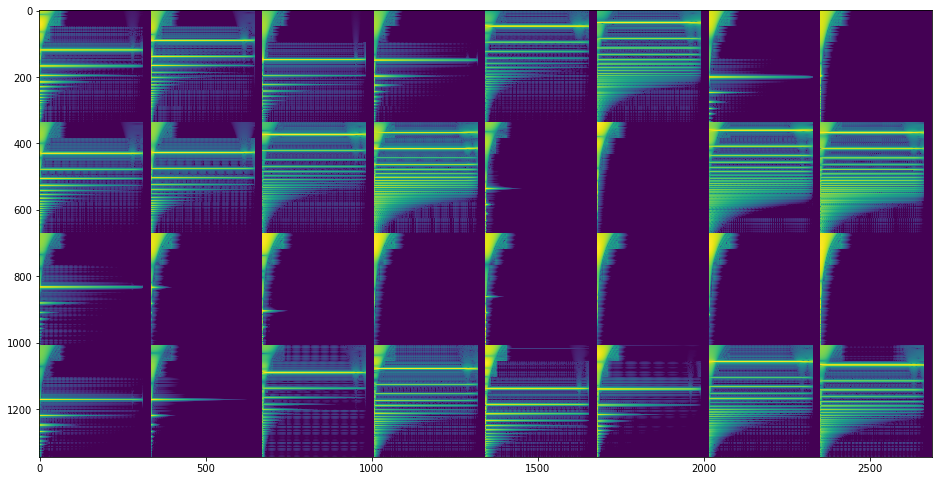

In [13]:
gt_samples, gt_pitches, gt_smoothing_factors, pred_samples, pred_pitches, pred_smoothing_factors = plot_cqts()

In [15]:
for i in range(len(gt_samples)):
    print("GT")
    display(Audio(gt_samples[i], rate=40000))
    print("Pred")
    display(Audio(pred_samples[i], rate=40000))

GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred
